In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
import torchvision, torch

In [3]:
#import torchsummary

In [4]:
#import hiddenlayer as hl

In [33]:
import sys, os
sys.path.insert(0,"../torchxrayvision/")
import torchxrayvision as xrv
import matplotlib.pyplot as plt
import torch
from torch.nn import functional as F
import glob
import numpy as np
import skimage, skimage.filters
from skimage.metrics import structural_similarity
from scipy.stats import spearmanr as spr, pearsonr
#from skimage import measure
#from skimage.metrics import structural_similarity
from skimage import feature

%matplotlib inline
import captum, captum.attr
import torch, torch.nn
import pickle
import attribution
import pandas as pd
import datasets
import shutil
import json
import glob
from cascading_randomization_utils import *
import seaborn as sns

In [6]:
# loading data
dmerge = datasets.get_data("nih")

# loading models
ae = xrv.autoencoders.ResNetAE(weights="101-elastic").cuda()
models = [xrv.models.DenseNet(weights="all").cuda(),
          xrv.baseline_models.jfhealthcare.DenseNet().cuda()]
models_toreset = [xrv.models.DenseNet(weights="all").cuda(),
                  xrv.baseline_models.jfhealthcare.DenseNet().cuda()]

NIH_Dataset num_samples=67310 views=['PA'] data_aug=None


In [7]:
model = models[0]
model_toreset=models_toreset[0]
print(model.pathologies)
print(model,model_toreset)

['Atelectasis', 'Consolidation', 'Infiltration', 'Pneumothorax', 'Edema', 'Emphysema', 'Fibrosis', 'Effusion', 'Pneumonia', 'Pleural_Thickening', 'Cardiomegaly', 'Nodule', 'Mass', 'Hernia', 'Lung Lesion', 'Fracture', 'Lung Opacity', 'Enlarged Cardiomediastinum']
XRV-DenseNet121-all XRV-DenseNet121-all


In [8]:
# display hierarchical structure of this model up to level of detail
# these keys can be used to specify which part to reset
sd=model.state_dict()
last_item=''
for k,v in sd.items():
    A=k.split('.')
    limit=2
    if len(A)>2 and 'dense' in A[2]:
        limit=3
    S=".".join(A[:min(len(A),limit)] + (['*'] if len(A)>limit else []))
    if S!=last_item:
        print(S)
        last_item=S
    #print(k,type(v))


op_threshs
features.conv0.*
features.norm0.*
features.denseblock1.denselayer1.*
features.denseblock1.denselayer2.*
features.denseblock1.denselayer3.*
features.denseblock1.denselayer4.*
features.denseblock1.denselayer5.*
features.denseblock1.denselayer6.*
features.transition1.*
features.denseblock2.denselayer1.*
features.denseblock2.denselayer2.*
features.denseblock2.denselayer3.*
features.denseblock2.denselayer4.*
features.denseblock2.denselayer5.*
features.denseblock2.denselayer6.*
features.denseblock2.denselayer7.*
features.denseblock2.denselayer8.*
features.denseblock2.denselayer9.*
features.denseblock2.denselayer10.*
features.denseblock2.denselayer11.*
features.denseblock2.denselayer12.*
features.transition2.*
features.denseblock3.denselayer1.*
features.denseblock3.denselayer2.*
features.denseblock3.denselayer3.*
features.denseblock3.denselayer4.*
features.denseblock3.denselayer5.*
features.denseblock3.denselayer6.*
features.denseblock3.denselayer7.*
features.denseblock3.denselayer

In [9]:
def weight_randomizer(model,key):
    #print("Reinitializing",key)
    keylist=key.split('.')
    M=model
    for k in keylist:
        M=M._modules[k]
    for i,m in enumerate(M.modules()):
        if isinstance(m, torch.nn.Conv2d):
            #print(f"===================================== {i} ==============================")
            #print(m)
            print("----Conv2d")
            m.reset_parameters()
            #torch.nn.init.kaiming_normal_(m.weight)
        elif isinstance(m, torch.nn.BatchNorm2d):
            #print(f"===================================== {i} ==============================")
            #print(m)
            print("----BatchNorm2d")
            m.reset_parameters()
            #torch.nn.init.constant_(m.weight, 1)
            #torch.nn.init.constant_(m.bias, 0)
        elif isinstance(m, torch.nn.Linear):
            #print(f"===================================== {i} ==============================")
            #print(m)
            print("----Linear")
            m.reset_parameters()
            #torch.nn.init.kaiming_normal_(m.weight)
            #torch.nn.init.constant_(m.bias, 0)


In [10]:
for_eval = [
            "Cardiomegaly",
            "Atelectasis",
            "Effusion",
            "Consolidation",
            "Edema",
            "Mass"
            ]

In [11]:
model.pathologies

['Atelectasis',
 'Consolidation',
 'Infiltration',
 'Pneumothorax',
 'Edema',
 'Emphysema',
 'Fibrosis',
 'Effusion',
 'Pneumonia',
 'Pleural_Thickening',
 'Cardiomegaly',
 'Nodule',
 'Mass',
 'Hernia',
 'Lung Lesion',
 'Fracture',
 'Lung Opacity',
 'Enlarged Cardiomediastinum']

In [12]:
for_eval

['Cardiomegaly', 'Atelectasis', 'Effusion', 'Consolidation', 'Edema', 'Mass']

In [13]:
class ModelWrapper(object):
    def __init__(self, model):
        self.model = model
        
##    def predict(self, batch):
##        return self.model.forward(batch)
    def reinit_layer_by_key(self, key, verbose=False):
        keylist=key.split('.')
        M=self.model
        for k in keylist:
            M=M._modules[k]
        for i,m in enumerate(M.modules()):
            if isinstance(m, torch.nn.Conv2d):
                #print(f"===================================== {i} ==============================")
                #print(m)
                if verbose:
                    print("----Conv2d")
                m.reset_parameters()
                #torch.nn.init.kaiming_normal_(m.weight)
            elif isinstance(m, torch.nn.BatchNorm2d):
                #print(f"===================================== {i} ==============================")
                #print(m)
                if verbose:
                    print("----BatchNorm2d")
                m.reset_parameters()
                #torch.nn.init.constant_(m.weight, 1)
                #torch.nn.init.constant_(m.bias, 0)
            elif isinstance(m, torch.nn.Linear):
                #print(f"===================================== {i} ==============================")
                #print(m)
                if verbose:
                    print("----Linear")
                m.reset_parameters()
                #torch.nn.init.kaiming_normal_(m.weight)
                #torch.nn.init.constant_(m.bias, 0)
            else:
                #print(f"===================================== {i} ==============================")
                #print(m)
                if verbose:
                    print("----Ignoring",type(m))
                #torch.nn.init.kaiming_normal_(m.weight)
                #torch.nn.init.constant_(m.bias, 0)

    def reinit_layer_at_index(self, layer_nb:int):
        """Reinitialize Tensors with this index."""
        M = list(self.model.modules())[layer_nb]
        for i,m in enumerate(M.modules()):
            if isinstance(m, torch.nn.Conv2d):
                #print(f"===================================== {i} ==============================")
                #print(m)
                print("----Conv2d")
                m.reset_parameters()
                #torch.nn.init.kaiming_normal_(m.weight)
            elif isinstance(m, torch.nn.BatchNorm2d):
                #print(f"===================================== {i} ==============================")
                #print(m)
                print("----BatchNorm2d")
                m.reset_parameters()
                #torch.nn.init.constant_(m.weight, 1)
                #torch.nn.init.constant_(m.bias, 0)
            elif isinstance(m, torch.nn.Linear):
                #print(f"===================================== {i} ==============================")
                #print(m)
                print("----Linear")
                m.reset_parameters()
                #torch.nn.init.kaiming_normal_(m.weight)
                #torch.nn.init.constant_(m.bias, 0)
            else:
                #print(f"===================================== {i} ==============================")
                #print(m)
                print("----Ignoring",type(m))
                #torch.nn.init.kaiming_normal_(m.weight)
                #torch.nn.init.constant_(m.bias, 0)

In [43]:
methods = ["grad", "guided", "integrated", "latentshift-max"]
#methods = ["grad", "latentshift-max"]
layers_to_randomize = ['classifier',
                       'features.norm5',
                       'features.denseblock4', 
                       'features.transition3', 
                       'features.denseblock3',
                       'features.transition2', 
                       'features.denseblock2',
                       'features.transition1', 
                       'features.denseblock1',
                       'features.norm0',
                       'features.conv0'
                      ]
layer_list = ['Full'] + layers_to_randomize
targets_to_process = for_eval
number_to_process = 40 #6
densenet_model = ModelWrapper(models_toreset[0])


In [44]:
temp_path = "/carl/rupert_brooks/output/temp"

============================================== Cardiomegaly
Processing Cardiomegaly
baseline saliency map for Cardiomegaly
tensor([0.5100])
[0.44826764] -370 20


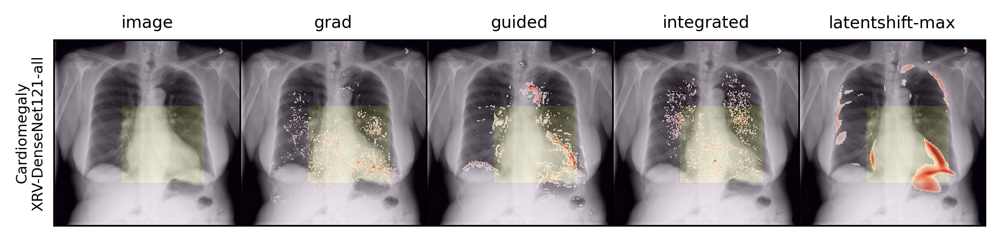

Length of demo batch 40
Processing without randomization
[0.6893909] -1000 510
[0.6280689] -1000 390
[0.3914846] -110 20
[0.71163327] -880 120
[0.5574434] -810 220
[0.44826764] -370 20
[0.55092824] -830 460
[0.654263] -1000 260
[0.30843136] -270 7
[0.5386044] -1000 1000
[0.53396726] -1000 530
[0.44066152] -210 4
[0.425283] -130 5
[0.67112374] -1000 280
[0.5654149] -1000 270
[0.6121459] -1000 620
[0.6037545] -430 120
[0.59499824] -1000 190
[0.5703951] -1000 620
[0.39375538] -130 2
[0.5377815] -1000 600
[0.56092775] -1000 490
[0.5430299] -520 140
[0.51318663] -750 420
[0.54830754] -290 110
[0.03422751] -1000 600
[0.5424298] -1000 660
[0.04760826] -1000 380
[0.62046677] -200 100
[0.63097876] -1000 100
[0.54168874] -1000 540
[0.12494247] -890 40
[0.07402122] -1000 160
[0.50138295] -1000 1000
[0.5173916] -1000 560
[0.39525196] -110 3
[0.5307524] -1000 510
[0.5001944] -1000 680
[0.10933811] -560 40
[0.4680718] -290 220
Cascading reinitialization up to on layer classifier
[0.71190035] -1000 1

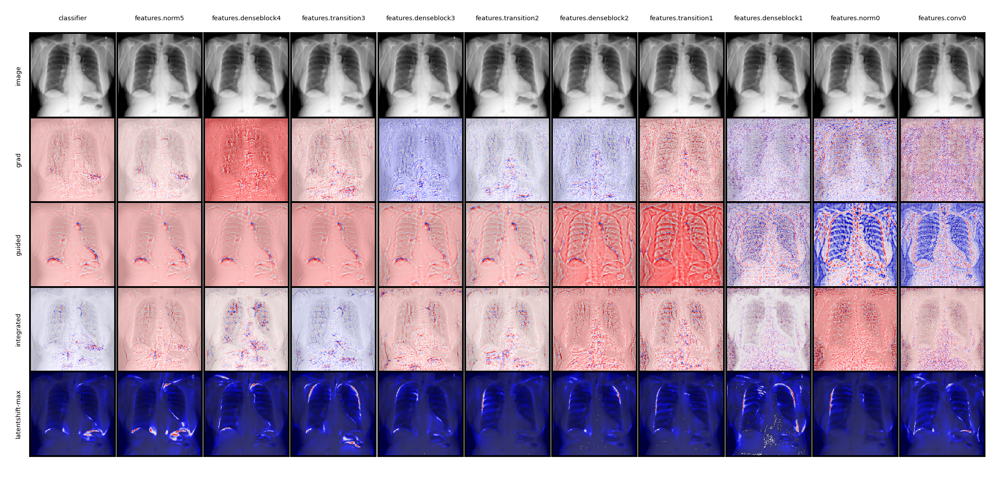

Computing measures
Compute and arrange results into dict in output list
============================================== Atelectasis
Processing Atelectasis
baseline saliency map for Atelectasis
tensor([0.3356])
[0.11388028] -1000 160


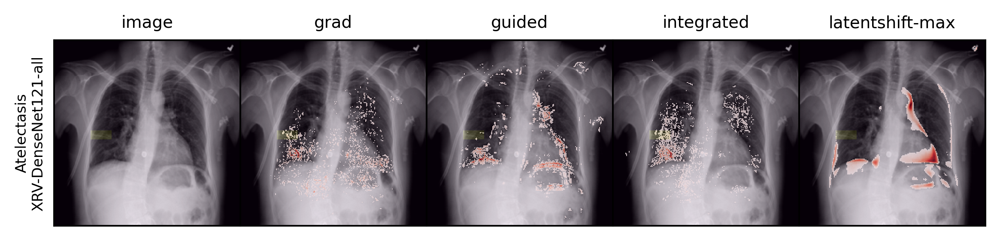

Length of demo batch 40
Processing without randomization
[0.04353969] -1000 1000
[0.45414904] -130 40
[0.3809155] -730 60
[0.5943421] -340 200
[0.08894693] -930 250
[0.11388028] -1000 160
[0.5499556] -1000 1000
[0.50227857] -1000 1000
[0.60545826] -1000 1000
[0.5202875] -660 680
[0.223057] -170 70
[0.18838319] -130 90
[0.51428837] -1000 470
[0.5020982] -680 100
[0.22372736] -600 70
[0.502054] -1000 1000
[0.54737103] -1000 470
[0.24728844] -90 80
[0.5122974] -1000 1000
[0.5494605] -260 1000
[0.22907154] -190 90
[0.51317453] -720 570
[0.34396163] -480 30
[0.53610665] -1000 1000
[0.24822545] -990 100
[0.5704684] -1000 1000
[0.04254429] -1000 1000
[0.5409577] -1000 1000
[0.5989535] -1000 1000
[0.530198] -1000 1000
[0.25191393] -200 60
[0.5150356] -1000 1000
[0.5543007] -1000 1000
[0.08105875] -860 300
[0.7163989] -1000 350
[0.21409859] -710 100
[0.50171083] -1000 1000
[0.16607736] -630 90
[0.5110382] -1000 1000
[0.28736162] -220 20
Cascading reinitialization up to on layer classifier
[0.71

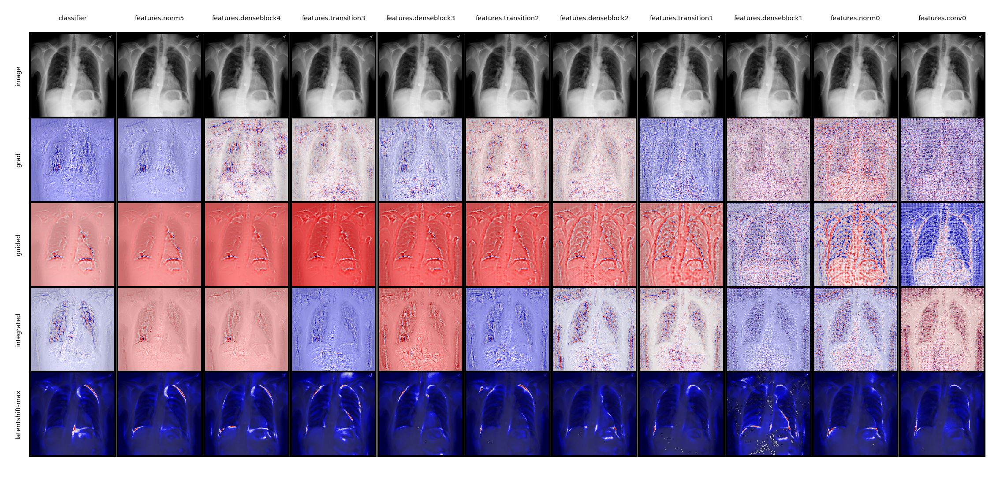

Computing measures
Compute and arrange results into dict in output list
============================================== Effusion
Processing Effusion
baseline saliency map for Effusion
tensor([0.8543])
[0.5404265] -340 30


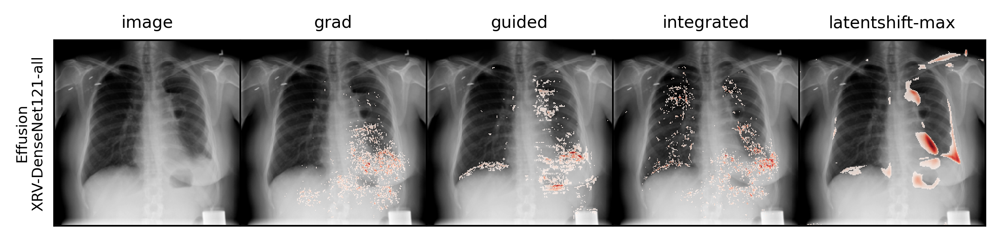

Length of demo batch 40
Processing without randomization
[0.5537524] -1000 350
[0.6825025] -660 110
[0.34095594] -60 6
[0.7094332] -290 50
[0.21845268] -60 7
[0.5404265] -340 30
[0.8096799] -1000 80
[0.7292639] -490 30
[0.5680183] -890 210
[0.83758307] -1000 150
[0.28534877] -140 5
[0.53131896] -1000 420
[0.36246514] -620 6
[0.5638398] -390 140
[0.53174037] -920 270
[0.5039674] -1000 330
[0.5553905] -190 30
[0.1772131] -1000 100
[0.738655] -230 20
[0.5451219] -210 50
[0.53531027] -70 120
[0.5745493] -370 90
[0.6312505] -500 110
[0.7282568] -260 20
[0.3732052] -50 4
[0.511204] -270 280
[0.6427685] -790 40
[0.18098328] -140 10
[0.275985] -210 8
[0.6950829] -1000 120
[0.8156253] -500 270
[0.62516046] -640 100
[0.66923237] -420 60
[0.7894353] -900 120
[0.72294044] -1000 340
[0.56347585] -980 200
[0.05687232] -1000 260
[0.6439859] -1000 160
[0.67565125] -1000 110
[0.66387236] -1000 50
Cascading reinitialization up to on layer classifier
[0.72500294] -1000 1000
[0.72092956] -1000 1000
[0.724

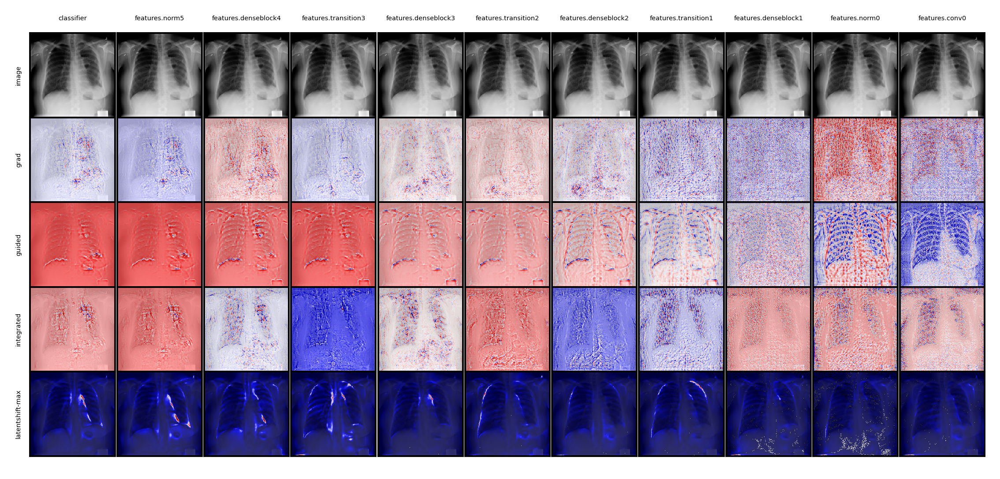

Computing measures
Compute and arrange results into dict in output list
============================================== Consolidation
Processing Consolidation
Warning, not enough examples with bounding boxes for class Consolidation using examples without bb
baseline saliency map for Consolidation
tensor([0.3312])
[0.2307093] -320 60


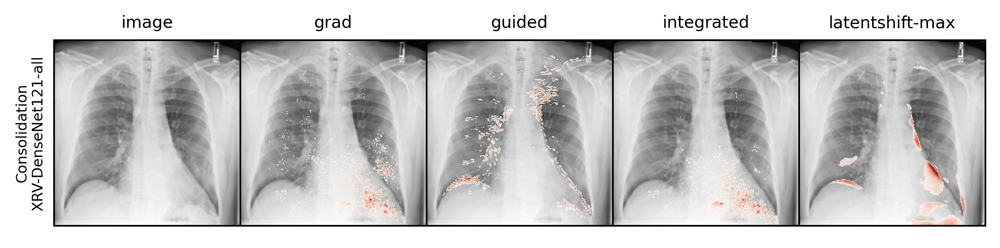

Length of demo batch 40
Processing without randomization
[0.1522677] -1000 110
[0.5193246] -1000 660
[0.4044062] -490 40
[0.2562024] -510 90
[0.5083934] -1000 1000
[0.2307093] -320 60
[0.50245357] -1000 1000
[0.5014384] -1000 1000
[0.52494997] -1000 1000
[0.12526485] -610 130
[0.07671059] -1000 520
[0.520921] -1000 1000
[0.5189937] -1000 1000
[0.51943666] -1000 1000
[0.5172659] -1000 1000
[0.25965512] -150 30
[0.24631344] -170 20
[0.5130185] -1000 1000
[0.535361] -1000 730
[0.4084824] -790 80
[0.09777187] -1000 1000
[0.21225838] -1000 160
[0.4810765] -130 30
[0.5178988] -410 610
[0.5078018] -360 1000
[0.13675928] -410 220
[0.19338468] -160 90
[0.5207105] -600 240
[0.52569294] -1000 1000
[0.5172579] -1000 1000
[0.5101025] -1000 1000
[0.52104187] -1000 1000
[0.54322565] -1000 630
[0.16254301] -790 160
[0.500474] -1000 850
[0.26568547] -210 140
[0.21518803] -510 230
[0.54332376] -40 8
[0.28611735] -110 20
[0.28732502] -300 60
Cascading reinitialization up to on layer classifier
[0.7270675

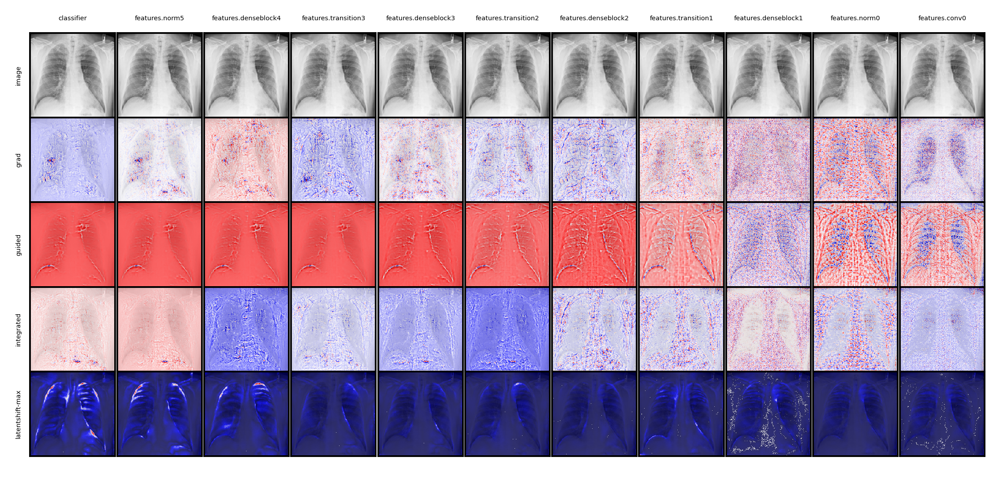

Computing measures
Compute and arrange results into dict in output list
============================================== Edema
Processing Edema
Warning, not enough examples with bounding boxes for class Edema using examples without bb
baseline saliency map for Edema
tensor([0.0991])
[0.0189479] -1000 1000


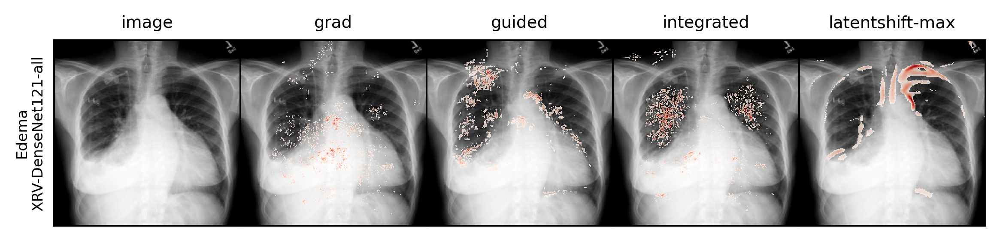

Length of demo batch 40
Processing without randomization
[0.00452026] -1000 1000
[0.00420408] -1000 1000
[0.08515376] -1000 1000
[0.01817372] -1000 1000
[0.02589911] -1000 1000
[0.0189479] -1000 1000
[0.00377163] -1000 1000
[0.00471653] -1000 1000
[0.01652887] -1000 1000
[0.06342932] -1000 300
[0.00108043] -1000 1000
[0.00682195] -1000 1000
[0.00642254] -1000 1000
[0.03311687] -1000 1000
[0.00170382] -1000 1000
[0.04682125] -1000 590
[0.00117946] -1000 1000
[0.00788483] -1000 1000
[0.0001787] -1000 1000
[2.3969837e-05] -7 4
[0.00050346] -1000 1000
[0.0337807] -1000 830
[0.03024848] -1000 1000
[0.03540142] -1000 1000
[0.00486511] -1000 1000
[0.00207666] -1000 1000
[0.0097969] -1000 1000
[0.01343422] -1000 1000
[0.00436908] -1000 1000
[0.00197532] -1000 1000
[8.015462e-05] -1000 10
[0.00171949] -1000 1000
[0.00149302] -1000 1000
[0.00010757] -1000 6
[0.00045446] -1000 1000
[0.00213085] -1000 1000
[0.02144518] -1000 1000
[0.00226533] -1000 1000
[6.888873e-05] -1000 1000
[0.02320773] -1000

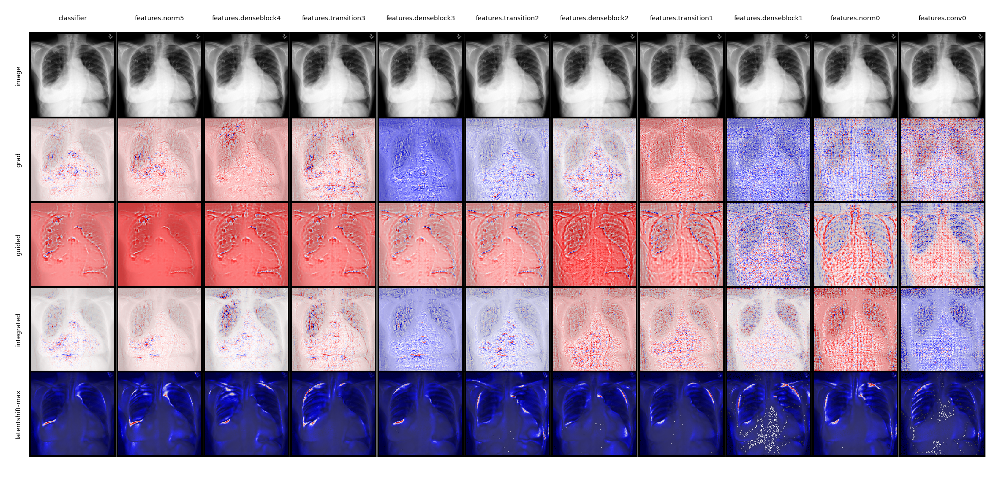

Computing measures
Compute and arrange results into dict in output list


In [ ]:
# dictionaries to save all of the metrics.
metric_output=[]
        
for target in targets_to_process:
    print("==============================================",target)
    print("Processing",target)
    dwhere = np.where(dmerge.csv.has_masks & (dmerge.labels[:,dmerge.pathologies.index(target)]  == 1))[0]
    if len(dwhere) < number_to_process:
        dwhere = np.where((dmerge.labels[:,dmerge.pathologies.index(target)]  == 1))[0]
        print("Warning, not enough examples with bounding boxes for class", target, "using examples without bb")
        if len(dwhere) < number_to_process:
            print("Warning, not enough positive examples for class", target, "using", len(dwhere))
    idx = 5
    sample = dmerge[dwhere[idx]]
    model = models[0]
    print("baseline saliency map for",target)
    saliency_map=attribution.generate_attributions(sample, model, target, ae, temp_path, dmerge)
    demo_batch = [dmerge[each] for each in dwhere[:min(number_to_process, len(dwhere))]]
    print("Length of demo batch",len(demo_batch))
    
    # setup
    master_cascading_randomization_dictionary = {} # key will be layer name.
    # reset the params
    densenet_model.model.load_state_dict(model.state_dict())

    # start without randomization
    print("Processing without randomization")
    output_of_original_model = []
    for current_sample in demo_batch:
        image = torch.from_numpy(current_sample["img"]).unsqueeze(0).cuda()
        saliency_maps = {}
        for method in methods:
            saliency_maps[method]=attribution.compute_attribution(image, method, densenet_model.model, target, ae=ae, take_abs=False, threshold=False)
        output_of_original_model.append( saliency_maps ) 
    master_cascading_randomization_dictionary['Full'] = output_of_original_model

    # begin randomization
    for i, layer in enumerate(layers_to_randomize):
        print("Cascading reinitialization up to on layer {}".format(layer))

        # reinitialize a particular layer,
        # all previously re-initialized are kept as is - cascades
        #
        densenet_model.reinit_layer_by_key(layer)

        # list to store collection of images
        list_of_random_mask_per_layer = []
        for j, current_sample in enumerate(demo_batch):
            image = torch.from_numpy(current_sample["img"]).unsqueeze(0).cuda()
            saliency_maps = {}
            for method in methods:
                saliency_maps[method]=attribution.compute_attribution(image, method, densenet_model.model, target, ae=ae, take_abs=False, threshold=False)
            list_of_random_mask_per_layer.append( saliency_maps )
            # now add the list of random masks to the dictionary
        master_cascading_randomization_dictionary[layer] = list_of_random_mask_per_layer

    print("Creating the normalized images")
    master_cascading_randomization_dictionary_abs_norm = {}
    master_cascading_randomization_dictionary_no_abs_norm = {}
    master_cascading_randomization_dictionary_0_1_norm = {}

    for layer_index, layer_output in master_cascading_randomization_dictionary.items():
        mask_list_abs_norm = []
        mask_list_no_abs_norm = []
        mask_list_0_1_norm = []
        for i, mask_dict in enumerate(layer_output):
        # first append original image
            new_dict_abs_norm = {}
            new_dict_no_abs_norm = {}
            new_dict_0_1_norm = {}
            for key in mask_dict:
                mask = mask_dict[key]

                mask_abs_norm = abs_grayscale_norm(mask)
                mask_no_abs_norm = diverging_norm(mask)
                mask_0_1_norm = normalize_image(mask)

                new_dict_abs_norm[key] = mask_abs_norm
                new_dict_no_abs_norm[key] = mask_no_abs_norm
                new_dict_0_1_norm[key] = mask_0_1_norm

            mask_list_abs_norm.append(new_dict_abs_norm)
            mask_list_no_abs_norm.append(new_dict_no_abs_norm)
            mask_list_0_1_norm.append(new_dict_0_1_norm)
        master_cascading_randomization_dictionary_abs_norm[layer_index] = mask_list_abs_norm
        master_cascading_randomization_dictionary_no_abs_norm[layer_index] = mask_list_no_abs_norm
        master_cascading_randomization_dictionary_0_1_norm[layer_index] = mask_list_0_1_norm
        
    ## UNIT TEST OF EXPECTIONS AT THIS POINT
    for key in master_cascading_randomization_dictionary:
        assert len(master_cascading_randomization_dictionary[key])==len(master_cascading_randomization_dictionary_no_abs_norm[key])
        for i, item in enumerate(master_cascading_randomization_dictionary[key]):
            assert len(item)==len(master_cascading_randomization_dictionary_no_abs_norm[key][i])
    for key in master_cascading_randomization_dictionary:
        assert len(master_cascading_randomization_dictionary[key])==len(master_cascading_randomization_dictionary_abs_norm[key])
        for i, item in enumerate(master_cascading_randomization_dictionary[key]):
            assert len(item)==len(master_cascading_randomization_dictionary_abs_norm[key][i])
    for key in master_cascading_randomization_dictionary:
        assert len(master_cascading_randomization_dictionary[key])==len(master_cascading_randomization_dictionary_0_1_norm[key])
        for i, item in enumerate(master_cascading_randomization_dictionary[key]):
            assert len(item)==len(master_cascading_randomization_dictionary_0_1_norm[key][i])
    
    print("Visualizing generated saliency maps")
    index_to_input_to_plot = min(idx, len(demo_batch)-1) # this must be less than the len of demo_batch
    current_sample = demo_batch[index_to_input_to_plot]
    image = torch.from_numpy(current_sample["img"]).unsqueeze(0).detach().cpu()[0][0]
    nb_layers=len(layers_to_randomize)
    fig, ax = plt.subplots(len(methods) + 1, nb_layers, figsize=(8,8/nb_layers*(len(methods)+1)), dpi=350)
    for i, method in enumerate(['image'] + methods):
        for j, layer in enumerate(layers_to_randomize):
            if method == "image":
                ax[i][j].imshow(image, interpolation='none', cmap="gray")
                ax[i][j].set_title(layer, fontsize=3)
            else:
                dimage = master_cascading_randomization_dictionary[layer][index_to_input_to_plot][method].copy()
                ax[i][j].imshow(image, interpolation='none', cmap="gray")
                dimage[dimage==0] = np.nan
                ax[i][j].imshow(dimage, interpolation='none', alpha=0.8, cmap="seismic");
            ax[i][j].get_xaxis().set_visible(False)
            ax[i][j].set_yticks([])
            #ax[i].get_yaxis().set_visible(False)
            if j==0:
                ax[i][j].set_ylabel(method, fontsize=3)
    fig.subplots_adjust(wspace=0, hspace=0);
    plt.show()
            
    print("Computing measures")
    layers=list(master_cascading_randomization_dictionary_abs_norm.keys())
    methods_list = list(master_cascading_randomization_dictionary_abs_norm[layers[0]][0].keys())

    print("Compute and arrange results into dict in output list")
    for l, layer in enumerate(layers):
        #if l == 0: 
        #    continue
        layer_name="%02d %s"%(l, layer.split('.')[-1])
        for i in range(len(master_cascading_randomization_dictionary_abs_norm[layer])):
            for method in methods_list:
                normal_mask_abs_norm = master_cascading_randomization_dictionary_abs_norm[layers[0]][i][method]
                normal_mask_no_abs_norm = master_cascading_randomization_dictionary_no_abs_norm[layers[0]][i][method]
                normal_mask_0_1_norm = master_cascading_randomization_dictionary_0_1_norm[layers[0]][i][method]


                rand_mask_abs_norm = master_cascading_randomization_dictionary_abs_norm[layer][i][method]
                rand_mask_no_abs_norm = master_cascading_randomization_dictionary_no_abs_norm[layer][i][method]
                rand_mask_0_1_norm = master_cascading_randomization_dictionary_0_1_norm[layer][i][method]

                # compute rank correlation
                rk_abs_abs_value_norm, _ = spr(normal_mask_abs_norm.flatten(), rand_mask_abs_norm.flatten())
                rk_no_abs_value_norm, _ = spr(normal_mask_no_abs_norm.flatten(), rand_mask_no_abs_norm.flatten())

                # compute ssim
                ss1 = structural_similarity(normal_mask_0_1_norm, rand_mask_0_1_norm,
                           gaussian_weights=True, multichannel=True)

                # rank correlation between histogram of gradients
                normal_hog = feature.hog(normal_mask_0_1_norm,
                                         pixels_per_cell=(16, 16))
                rand_hog = feature.hog(rand_mask_0_1_norm,
                                       pixels_per_cell=(16, 16))
                rank_corr_hog = spr(normal_hog, rand_hog)[0]

                metric_output.append({
                    'target': target,
                    'layer': layer_name,
                    'image': i,
                    'method': method,
                    'spearman_abs': rk_abs_abs_value_norm,
                    'spearman': rk_no_abs_value_norm,
                    'ssim': ss1,
                    'hog spearman': rank_corr_hog,
                })

            

In [52]:
metrics_df=pd.DataFrame(metric_output)
metrics_df

,target,layer,image,method,spearman_abs,spearman,ssim,hog spearman
0,Cardiomegaly,00 Full,0,grad,1.000000,1.000000,1.000000,1.000000
1,Cardiomegaly,00 Full,0,guided,1.000000,1.000000,1.000000,1.000000
2,Cardiomegaly,00 Full,0,integrated,1.000000,1.000000,1.000000,1.000000
3,Cardiomegaly,00 Full,0,latentshift-max,1.000000,1.000000,1.000000,1.000000
4,Cardiomegaly,00 Full,1,grad,1.000000,1.000000,1.000000,1.000000
...,...,...,...,...,...,...,...,...
11515,Mass,11 conv0,38,latentshift-max,0.187658,0.187658,0.625063,0.452834
11516,Mass,11 conv0,39,grad,-0.001725,0.008103,0.433840,0.023561
11517,Mass,11 conv0,39,guided,0.225058,0.491578,0.601856,0.362733
11518,Mass,11 conv0,39,integrated,0.241812,-0.000532,0.628405,0.333079


In [57]:
# very long to calculate so save / load it if needed
#metrics_df.to_pickle("ComputedCascadingRandomization_20210214.pkl.gz")
#metrics_df=pd.read_pickle("ComputedCascadingRandomization_20210214.pkl.gz")

In [53]:
df = metrics_df.groupby(by=['target','layer','method']).mean()
display(df)

image  spearman_abs  spearman  \
target      layer         method                                           
Atelectasis 00 Full       grad              19.5      1.000000  1.000000   
                          guided            19.5      1.000000  1.000000   
                          integrated        19.5      1.000000  1.000000   
                          latentshift-max   19.5      1.000000  1.000000   
            01 classifier grad              19.5      0.550548  0.129725   
...                                          ...           ...       ...   
Mass        10 norm0      latentshift-max   19.5      0.294194  0.294194   
            11 conv0      grad              19.5      0.025631 -0.005264   
                          guided            19.5      0.212664  0.483828   
                          integrated        19.5      0.257903 -0.001380   
                          latentshift-max   19.5      0.262628  0.262628   

                                               ssim  hog spearman  
target      layer         method                                   
Atelectasis 00 Full       grad             1.000000      1.000000  
                          guided           1.000000      1.000000  
                          integrated       1.000000      1.000000  
                          latentshift-max  1.000000      1.000000  
            01 classifier grad             0.854481      0.618254  
...                                             ...           ...  
Mass        10 norm0      latentshift-max  0.618356      0.584236  
            11 conv0      grad             0.423403      0.049322  
                          guided           0.573085      0.332266  
                          integrated       0.642162      0.353269  
                          latentshift-max  0.609734      0.543735  

[288 rows x 5 columns]

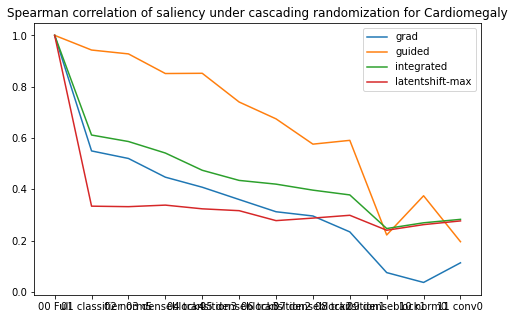

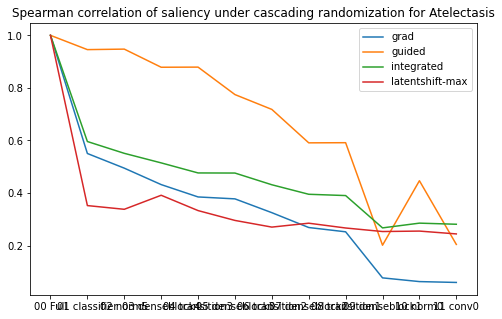

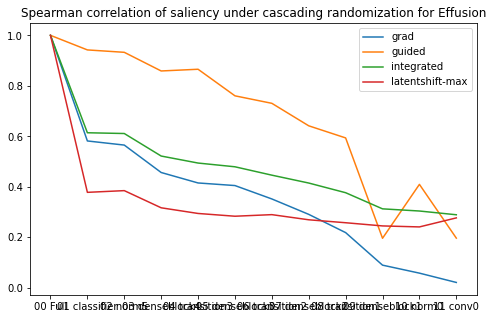

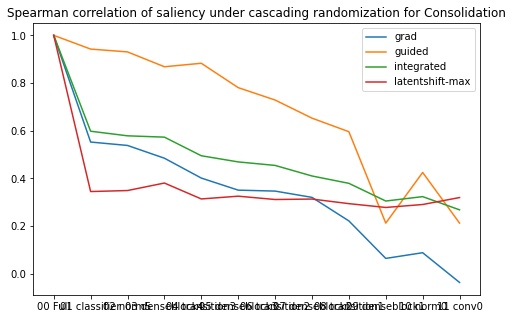

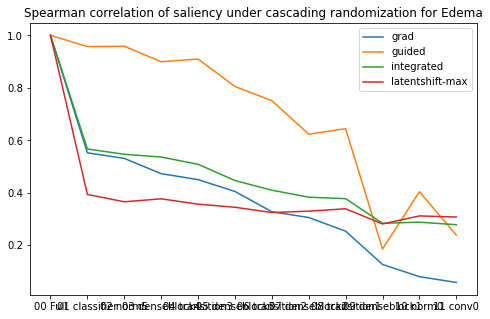

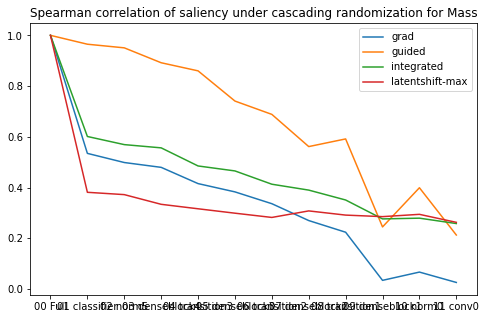

In [55]:
for target in targets_to_process:
    tmp=df.reset_index()
    tmp=tmp.loc[tmp['target']==target]
    labels=tmp["layer"].drop_duplicates().to_list()
    data=dict()
    for method in methods:
        data[method]=tmp.loc[tmp['method']==method]['spearman_abs'].values
    fig=plt.figure(figsize=(8,5))
    for k,v in data.items():
        plt.plot(v,label=k)
    plt.xticks(range(len(v)),labels)
    plt.legend()
    #plt.ylabel("Spearman Correlation (abs)")
    plt.title("Spearman correlation of saliency under cascading randomization for %s"%target)
    plt.show()

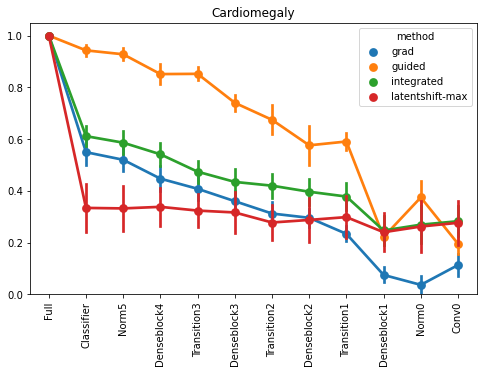

AttributeError: module 'matplotlib.pyplot' has no attribute 'save_fig'

In [70]:
for target in targets_to_process:
    plt.figure(figsize=(8,5))
    sns.pointplot(x='layer', y='spearman_abs', hue='method',data=metrics_df.loc[metrics_df['target']==target], ci='sd')
    plt.xticks(rotation=90)
    labels = [item.get_text() for item in plt.gca().get_xticklabels()]
    cleaned_labels = map(lambda x: x.split()[-1].capitalize(), labels)
    plt.gca().set_xticklabels(cleaned_labels)
    plt.title(target)
    plt.ylim([0,1.05])
    plt.ylabel(None)
    plt.xlabel(None)
    plt.show()
    plt.save_fig("%s_cascrand.png"%target)

In [69]:
!ls -l

total 35152
-rw-r--r-- 1 rupert_brooks users  2460455 Jan 27 18:10 ae-test-clean.ipynb
-rw-r--r-- 1 rupert_brooks users    13257 Feb 12 11:14 attribution_bak.py
-rw-r--r-- 1 rupert_brooks users    14209 Feb 12 14:59 attribution.py
-rw-r--r-- 1 rupert_brooks users 22262247 Feb 14 07:26 cascading_randomization.ipynb
-rw-r--r-- 1 rupert_brooks users     1065 Feb 12 13:56 cascading_randomization_utils.py
-rw-r--r-- 1 rupert_brooks users   323091 Feb 14 07:13 ComputedCascadingRandomization_20210214.pkl.gz
-rw-r--r-- 1 rupert_brooks users     4403 Feb 12 11:54 datasets.py
-rw-r--r-- 1 rupert_brooks users  1144092 Feb  4 10:22 gif-attributionmaps.ipynb
-rw-r--r-- 1 rupert_brooks users  1366439 Feb  4 10:23 gif-generate-opticalflow.ipynb
-rw-r--r-- 1 rupert_brooks users   103584 Feb 12 09:56 gif-generate-website2.ipynb
-rw-r--r-- 1 rupert_brooks users  1697147 Feb  4 10:29 gif-generate-website.ipynb
-rw-r--r-- 1 rupert_brooks users  1717290 Feb  4 10:30 gif-incorrect-features.ipynb
-rw-r--r-- 

In [ ]:
# below is probably to discard

In [ ]:
layers=list(master_cascading_randomization_dictionary_abs_norm.keys())
methods_list = list(master_cascading_randomization_dictionary_abs_norm[layers[0]][0].keys())

# dictionary to save all of the metrics.
rank_correlation_dictionary_abs_norm = {}
rank_correlation_dictionary_no_abs_norm = {}
ssim_dictionary_0_1_norm = {}
hog_dictionary_0_1_norm = {}

# initialize the dictionaries appropriately.
for layer in layers[1:]:
    rank_correlation_dictionary_abs_norm[layer] = {}
    rank_correlation_dictionary_no_abs_norm[layer] = {}
    ssim_dictionary_0_1_norm[layer] = {}
    hog_dictionary_0_1_norm[layer] = {}
    for method in methods_list:
        rank_correlation_dictionary_abs_norm[layer][method] = []
        rank_correlation_dictionary_no_abs_norm[layer][method] = []
        ssim_dictionary_0_1_norm[layer][method] = []
        hog_dictionary_0_1_norm[layer][method] = []
        
for layer in layers:
    if layer == layers[0]: 
        continue
    for i, mask_dict in enumerate(master_cascading_randomization_dictionary_abs_norm[layer]):
        for method in methods_list:
            normal_mask_abs_norm = master_cascading_randomization_dictionary_abs_norm[layers[0]][i][method]
            normal_mask_no_abs_norm = master_cascading_randomization_dictionary_no_abs_norm[layers[0]][i][method]
            normal_mask_0_1_norm = master_cascading_randomization_dictionary_0_1_norm[layers[0]][i][method]
            
            
            rand_mask_abs_norm = mask_dict[method]
            rand_mask_no_abs_norm = master_cascading_randomization_dictionary_no_abs_norm[layer][i][method]
            rand_mask_0_1_norm = master_cascading_randomization_dictionary_0_1_norm[layer][i][method]
            
            # compute rank correlation
            rk_abs_abs_value_norm, _ = spr(normal_mask_abs_norm.flatten(), rand_mask_abs_norm.flatten())
            rk_no_abs_value_norm, _ = spr(normal_mask_no_abs_norm.flatten(), rand_mask_no_abs_norm.flatten())
            
            # compute ssim
            ss1 = structural_similarity(normal_mask_0_1_norm, rand_mask_0_1_norm,
                       gaussian_weights=True, multichannel=True)
            
            # rank correlation between histogram of gradients
            normal_hog = feature.hog(normal_mask_0_1_norm,
                                     pixels_per_cell=(16, 16))
            rand_hog = feature.hog(rand_mask_0_1_norm,
                                   pixels_per_cell=(16, 16))
            rank_corr_hog = spr(normal_hog, rand_hog)[0]
            
            # collate all the values into their respective dictionaries.
            rank_correlation_dictionary_abs_norm[layer][method].append(rk_abs_abs_value_norm)
            rank_correlation_dictionary_no_abs_norm[layer][method].append(rk_no_abs_value_norm)
            ssim_dictionary_0_1_norm[layer][method].append(ss1)
            hog_dictionary_0_1_norm[layer][method].append(rank_corr_hog)

In [ ]:
methods_list = list(master_cascading_randomization_dictionary_abs_norm[layers[0]][0].keys())

# dictionary to save all of the metrics.
metric_output=[]
        
for l,layer in enumerate(layers):
    #if l == 0: 
    #    continue
    layer_name="%02d %s"%(l,layer.split('.')[-1])
    for i in range(len(master_cascading_randomization_dictionary_abs_norm[layer])):
        for method in methods_list:
            normal_mask_abs_norm = master_cascading_randomization_dictionary_abs_norm[layers[0]][i][method]
            normal_mask_no_abs_norm = master_cascading_randomization_dictionary_no_abs_norm[layers[0]][i][method]
            normal_mask_0_1_norm = master_cascading_randomization_dictionary_0_1_norm[layers[0]][i][method]
            
            
            rand_mask_abs_norm = master_cascading_randomization_dictionary_abs_norm[layer][i][method]
            rand_mask_no_abs_norm = master_cascading_randomization_dictionary_no_abs_norm[layer][i][method]
            rand_mask_0_1_norm = master_cascading_randomization_dictionary_0_1_norm[layer][i][method]
            
            # compute rank correlation
            rk_abs_abs_value_norm, _ = spr(normal_mask_abs_norm.flatten(), rand_mask_abs_norm.flatten())
            rk_no_abs_value_norm, _ = spr(normal_mask_no_abs_norm.flatten(), rand_mask_no_abs_norm.flatten())
            
            # compute ssim
            ss1 = structural_similarity(normal_mask_0_1_norm, rand_mask_0_1_norm,
                       gaussian_weights=True, multichannel=True)
            
            # rank correlation between histogram of gradients
            normal_hog = feature.hog(normal_mask_0_1_norm,
                                     pixels_per_cell=(16, 16))
            rand_hog = feature.hog(rand_mask_0_1_norm,
                                   pixels_per_cell=(16, 16))
            rank_corr_hog = spr(normal_hog, rand_hog)[0]
            
            metric_output.append({
                'layer': layer_name,
                'image': i,
                'method': method,
                'spearman_abs': rk_abs_abs_value_norm,
                'spearman': rk_no_abs_value_norm,
                'ssim': ss1,
                'hog spearman': rank_corr_hog,
            })
